In [48]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay, classification_report
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier

from sklearn.tree import plot_tree
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import classification_report

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from IPython.display import display

In [49]:
df = pd.read_csv("conversion_data_train.csv")
df

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0
...,...,...,...,...,...,...
284575,US,36,1,Ads,1,0
284576,US,31,1,Seo,2,0
284577,US,41,1,Seo,5,0
284578,US,31,1,Direct,4,0


EDA

country : Ce champ représente le pays d'origine de l'utilisateur. Par exemple, "China", "UK", "Germany", "US", etc.

age : L'âge de l'utilisateur. Ce champ indique l'âge de chaque individu ayant interagi avec le site.

new_user : Un indicateur binaire (0 ou 1) qui montre si l'utilisateur est un nouvel utilisateur (1) ou un utilisateur existant (0).

source : La source par laquelle l'utilisateur est arrivé sur le site. Les valeurs possibles sont par exemple :

Direct : L'utilisateur a accédé directement au site.
Ads : L'utilisateur est arrivé sur le site par une publicité.
Seo : L'utilisateur est arrivé par une recherche organique, c'est-à-dire via le référencement naturel sur les moteurs de recherche.
total_pages_visited : Le nombre total de pages que l'utilisateur a visitées lors de sa session sur le site.

converted : Ce champ binaire indique si l'utilisateur a été converti (1) ou non (0). Une conversion pourrait signifier une action comme l'achat d'un produit, l'inscription à un service, ou toute autre action définie comme un objectif du site.


Pays	Population (2025)
États-Unis	342 715 948
Chine	1 424 864 149
Royaume-Uni	68 072 841
Allemagne	83 228 580

In [50]:
df.shape

(284580, 6)

In [51]:
df.describe(include='all')

,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000


In [52]:
print ("nbre de valeurs null par colonne :\n")
df.isna().sum()

nbre de valeurs null par colonne :



country                0
age                    0
new_user               0
source                 0
total_pages_visited    0
converted              0
dtype: int64

In [53]:
px.histogram(df, 'country', 'converted')

In [54]:
px.histogram(df, 'age', 'converted')

In [55]:
px.histogram(df, 'source', 'converted')

In [56]:
px.histogram(df, 'total_pages_visited', 'converted')

In [57]:
target = 'converted'

x = df.drop(target, axis=1)
y = df[target].astype(str)

display(x.head(), y.head())

,country,age,new_user,source,total_pages_visited
0,China,22,1,Direct,2
1,UK,21,1,Ads,3
2,Germany,20,0,Seo,14
3,US,23,1,Seo,3
4,US,28,1,Direct,3


0    0
1    0
2    1
3    0
4    0
Name: converted, dtype: object

In [58]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

preprocessing

In [59]:
# Numerical # Standardize
# Categoric # Encode

x['new_user'] = x['new_user'].astype(str)

numerical_features = x.select_dtypes(include=np.number).columns.tolist()
categorical_features = x.select_dtypes(include=object).columns.tolist()


numerical_scaler = StandardScaler()
categorical_encoder = OneHotEncoder(drop='first')

numeric_pipeline = Pipeline([('numeric_scaler', numerical_scaler)])

categoric_pipeline = Pipeline([('categoric_encoder', categorical_encoder)])

preprocessor = ColumnTransformer([
  ('numeric_pipeline', numeric_pipeline, numerical_features),
  ('categoric_pipeline', categoric_pipeline, categorical_features),
                              ])

# Encode labels
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(y_train)
y_test = label_encoder.transform(y_test)

print (numerical_features)
print (categorical_features)

['age', 'total_pages_visited']
['country', 'new_user', 'source']


In [60]:
preprocessor.fit(x_train)
x_train = preprocessor.transform(x_train)
x_test = preprocessor.transform(x_test)

print (x_train)
print (y_train)
print (x_test)


[[-1.27650481 -0.2618471   0.         ...  1.          0.
   0.        ]
 [-0.18867057 -0.56090876  0.         ...  1.          0.
   0.        ]
 [ 0.65742272 -0.56090876  0.         ...  0.          0.
   1.        ]
 ...
 [-1.03476387  0.63533789  0.         ...  1.          0.
   1.        ]
 [-0.18867057  0.03721457  0.         ...  0.          0.
   1.        ]
 [-0.0678001  -0.2618471   0.         ...  0.          0.
   1.        ]]
[0 0 0 ... 0 0 0]
[[ 0.17394084 -0.2618471   0.         ...  1.          0.
   1.        ]
 [-0.0678001   0.03721457  0.         ...  1.          0.
   1.        ]
 [ 0.05307037  0.03721457  0.         ...  1.          0.
   1.        ]
 ...
 [ 1.26177508 -0.56090876  0.         ...  1.          0.
   1.        ]
 [ 1.26177508  0.33627623  0.         ...  0.          0.
   0.        ]
 [-0.79302293 -0.56090876  0.         ...  1.          0.
   1.        ]]


In [61]:
preprocessor.get_feature_names_out()

array(['numeric_pipeline__age', 'numeric_pipeline__total_pages_visited',
       'categoric_pipeline__country_Germany',
       'categoric_pipeline__country_UK', 'categoric_pipeline__country_US',
       'categoric_pipeline__new_user_1',
       'categoric_pipeline__source_Direct',
       'categoric_pipeline__source_Seo'], dtype=object)

In [62]:
dt_gini = DecisionTreeClassifier(criterion='gini')
dt_gini.fit(x_train, y_train)

DecisionTreeClassifier()

[Text(0.6152279169233014, 0.9791666666666666, 'x[1] <= 2.28\ngini = 0.062\nsamples = 227664\nvalue = [220320, 7344]'),
 Text(0.38734825043598137, 0.9375, 'x[1] <= 1.682\ngini = 0.02\nsamples = 220505\nvalue = [218300, 2205]'),
 Text(0.5012880836796414, 0.9583333333333333, 'True  '),
 Text(0.23325734279672006, 0.8958333333333334, 'x[1] <= 1.084\ngini = 0.01\nsamples = 214061\nvalue = [212967, 1094]'),
 Text(0.13653369144059005, 0.8541666666666666, 'x[1] <= 0.785\ngini = 0.005\nsamples = 199459\nvalue = [198992, 467]'),
 Text(0.07364808695671285, 0.8125, 'x[1] <= 0.187\ngini = 0.003\nsamples = 186765\nvalue = [186494, 271]'),
 Text(0.033452159082917224, 0.7708333333333334, 'x[5] <= 0.5\ngini = 0.001\nsamples = 148051\nvalue = [147973, 78]'),
 Text(0.01873813207679865, 0.7291666666666666, 'x[1] <= -0.112\ngini = 0.003\nsamples = 44465\nvalue = [44408, 57]'),
 Text(0.007903157746676982, 0.6875, 'x[1] <= -0.411\ngini = 0.001\nsamples = 36510\nvalue = [36487, 23]'),
 Text(0.00270764470075251

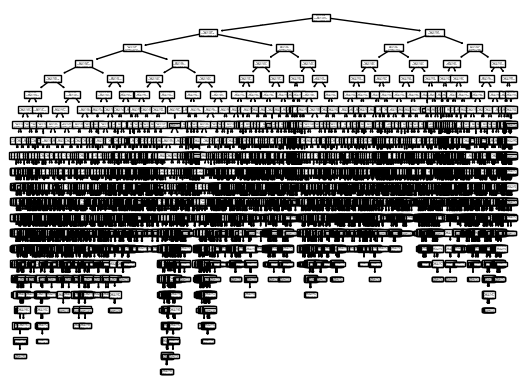

In [63]:
plot_tree(dt_gini)

In [64]:
dt_entropy = DecisionTreeClassifier(criterion='entropy')
dt_entropy.fit(x_train, y_train)

DecisionTreeClassifier(criterion='entropy')

[Text(0.5250020779439627, 0.9791666666666666, 'x[1] <= 1.981\nentropy = 0.206\nsamples = 227664\nvalue = [220320, 7344]'),
 Text(0.2242135160007378, 0.9375, 'x[1] <= 0.785\nentropy = 0.062\nsamples = 217913\nvalue = [216342, 1571]'),
 Text(0.37460779697235025, 0.9583333333333333, 'True  '),
 Text(0.08050324956277782, 0.8958333333333334, 'x[1] <= 0.187\nentropy = 0.016\nsamples = 186765\nvalue = [186494, 271]'),
 Text(0.03391603056911754, 0.8541666666666666, 'x[5] <= 0.5\nentropy = 0.006\nsamples = 148051\nvalue = [147973, 78]'),
 Text(0.014736892443343292, 0.8125, 'x[1] <= -0.411\nentropy = 0.014\nsamples = 44465\nvalue = [44408, 57]'),
 Text(0.0038985644538366247, 0.7708333333333334, 'x[0] <= -0.37\nentropy = 0.003\nsamples = 27671\nvalue = [27665, 6]'),
 Text(0.001967499817824091, 0.7291666666666666, 'x[4] <= 0.5\nentropy = 0.006\nsamples = 10751\nvalue = [10746, 5]'),
 Text(0.001676018363331633, 0.6875, 'entropy = 0.0\nsamples = 4673\nvalue = [4673, 0]'),
 Text(0.002258981272316549,

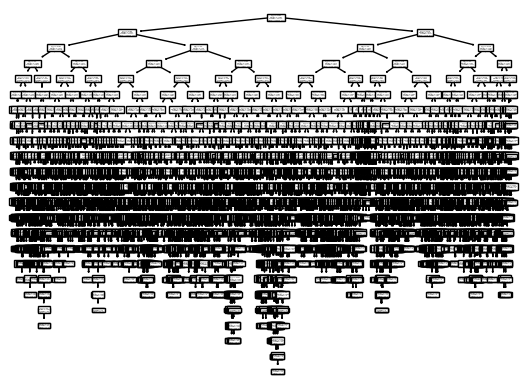

In [65]:
plot_tree(dt_entropy)

[Text(0.5, 0.875, 'x[1] <= 2.28\ngini = 0.062\nsamples = 227664\nvalue = [220320, 7344]'),
 Text(0.25, 0.625, 'x[1] <= 1.682\ngini = 0.02\nsamples = 220505\nvalue = [218300, 2205]'),
 Text(0.375, 0.75, 'True  '),
 Text(0.125, 0.375, 'x[1] <= 1.084\ngini = 0.01\nsamples = 214061\nvalue = [212967, 1094]'),
 Text(0.0625, 0.125, 'gini = 0.005\nsamples = 199459\nvalue = [198992, 467]'),
 Text(0.1875, 0.125, 'gini = 0.082\nsamples = 14602\nvalue = [13975, 627]'),
 Text(0.375, 0.375, 'x[5] <= 0.5\ngini = 0.285\nsamples = 6444\nvalue = [5333, 1111]'),
 Text(0.3125, 0.125, 'gini = 0.442\nsamples = 2427\nvalue = [1627, 800]'),
 Text(0.4375, 0.125, 'gini = 0.143\nsamples = 4017\nvalue = [3706, 311]'),
 Text(0.75, 0.625, 'x[1] <= 2.878\ngini = 0.405\nsamples = 7159\nvalue = [2020.0, 5139.0]'),
 Text(0.625, 0.75, '  False'),
 Text(0.625, 0.375, 'x[5] <= 0.5\ngini = 0.499\nsamples = 3073\nvalue = [1591.0, 1482.0]'),
 Text(0.5625, 0.125, 'gini = 0.436\nsamples = 1567\nvalue = [504, 1063]'),
 Text(0.6

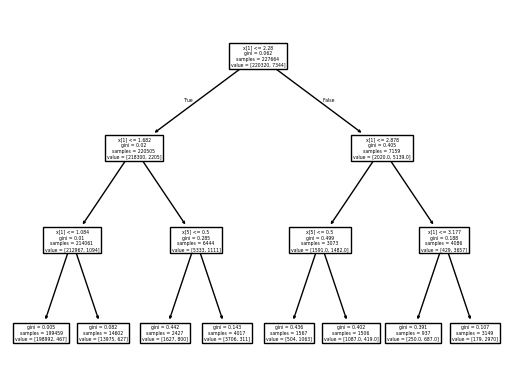

In [66]:
dt_mini_gini = DecisionTreeClassifier(max_depth=3)
dt_mini_gini.fit(x_train,y_train)
plot_tree(dt_mini_gini)

[Text(0.5, 0.875, 'x[1] <= 1.981\nentropy = 0.206\nsamples = 227664\nvalue = [220320, 7344]'),
 Text(0.25, 0.625, 'x[1] <= 0.785\nentropy = 0.062\nsamples = 217913\nvalue = [216342, 1571]'),
 Text(0.375, 0.75, 'True  '),
 Text(0.125, 0.375, 'x[1] <= 0.187\nentropy = 0.016\nsamples = 186765\nvalue = [186494, 271]'),
 Text(0.0625, 0.125, 'entropy = 0.006\nsamples = 148051\nvalue = [147973, 78]'),
 Text(0.1875, 0.125, 'entropy = 0.045\nsamples = 38714\nvalue = [38521, 193]'),
 Text(0.375, 0.375, 'x[5] <= 0.5\nentropy = 0.25\nsamples = 31148\nvalue = [29848, 1300]'),
 Text(0.3125, 0.125, 'entropy = 0.437\nsamples = 9905\nvalue = [9011, 894]'),
 Text(0.4375, 0.125, 'entropy = 0.136\nsamples = 21243\nvalue = [20837, 406]'),
 Text(0.75, 0.625, 'x[1] <= 2.878\nentropy = 0.975\nsamples = 9751\nvalue = [3978, 5773]'),
 Text(0.625, 0.75, '  False'),
 Text(0.625, 0.375, 'x[5] <= 0.5\nentropy = 0.953\nsamples = 5665\nvalue = [3549, 2116]'),
 Text(0.5625, 0.125, 'entropy = 0.979\nsamples = 2596\nval

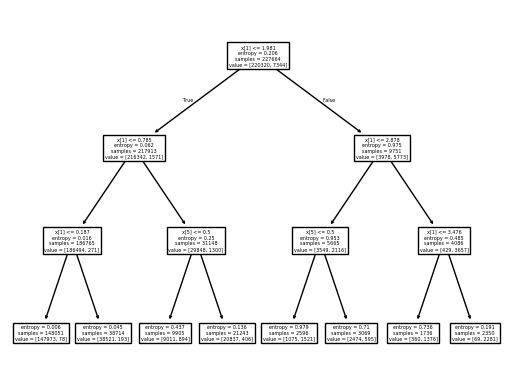

In [67]:
dt_mini_entropy = DecisionTreeClassifier(max_depth=3, criterion = 'entropy')
dt_mini_entropy.fit(x_train,y_train)
plot_tree(dt_mini_entropy)

In [68]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
import matplotlib.pyplot as plt
import pandas as pd

def graph_perf(dt_model, x_train, y_train, x_test, y_test, label_encoder, title):
    # Créer une figure avec deux sous-graphiques empilés verticalement
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), gridspec_kw={'width_ratios': [1, 0.5]})
    fig.suptitle(title, fontsize=16)

    # Fonction pour afficher la matrice de confusion avec pourcentages
    def plot_confusion_matrix(ax, y_true, y_pred, labels):
        cm = confusion_matrix(y_true, y_pred, labels=label_encoder.transform(labels))
        cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
        disp.plot(cmap='Blues', values_format='d', ax=ax, colorbar=False)

        # Ajouter uniquement les pourcentages
        for i in range(cm.shape[0]):
            for j in range(cm.shape[1]):
                ax.text(j, i-0.1, f'({cm_normalized[i, j]*100:.1f}%)', 
                        ha='center', va='bottom', color='black', fontsize=10)


    # Matrice de confusion pour l'ensemble d'entraînement
    y_pred_train = dt_model.predict(x_train)
    plot_confusion_matrix(axes[0, 0], y_train, y_pred_train, label_encoder.classes_)
    axes[0, 0].set_title("Matrice de Confusion (Train)", fontsize=14)
    axes[0, 0].tick_params(axis='both', which='major', labelsize=12)

    # Matrice de confusion pour l'ensemble de test
    y_pred_test = dt_model.predict(x_test)
    plot_confusion_matrix(axes[1, 0], y_test, y_pred_test, label_encoder.classes_)
    axes[1, 0].set_title("Matrice de Confusion (Test)", fontsize=14)
    axes[1, 0].tick_params(axis='both', which='major', labelsize=12)

    # Fonction pour ajouter les métriques de performance sous forme de tableau
    def add_performance_table(ax, y_true, y_pred, labels):
        report = classification_report(y_true, y_pred, target_names=labels, output_dict=True)
        report_df = pd.DataFrame(report).transpose()

        # Arrondir les métriques à deux chiffres après la virgule
        report_df = report_df.applymap(lambda x: f'{x:.2f}' if isinstance(x, float) else x)

        # Afficher le tableau
        table = ax.table(cellText=report_df.values, colLabels=report_df.columns, rowLabels=report_df.index, cellLoc='center', loc='center')
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1.2, 1.2)
        ax.axis('off')

    # Ajouter les métriques de performance pour l'ensemble d'entraînement
    add_performance_table(axes[0, 1], y_train, y_pred_train, label_encoder.classes_)
    axes[0, 1].set_title("Performance (Train)", fontsize=14)

    # Ajouter les métriques de performance pour l'ensemble de test
    add_performance_table(axes[1, 1], y_test, y_pred_test, label_encoder.classes_)
    axes[1, 1].set_title("Performance (Test)", fontsize=14)

    # Afficher le graphique
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# Exemple d'utilisation de la fonction
# graph_perf(dt_best, x_train, y_train, x_test, y_test, label_encoder, title="Performance du Modèle")


C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



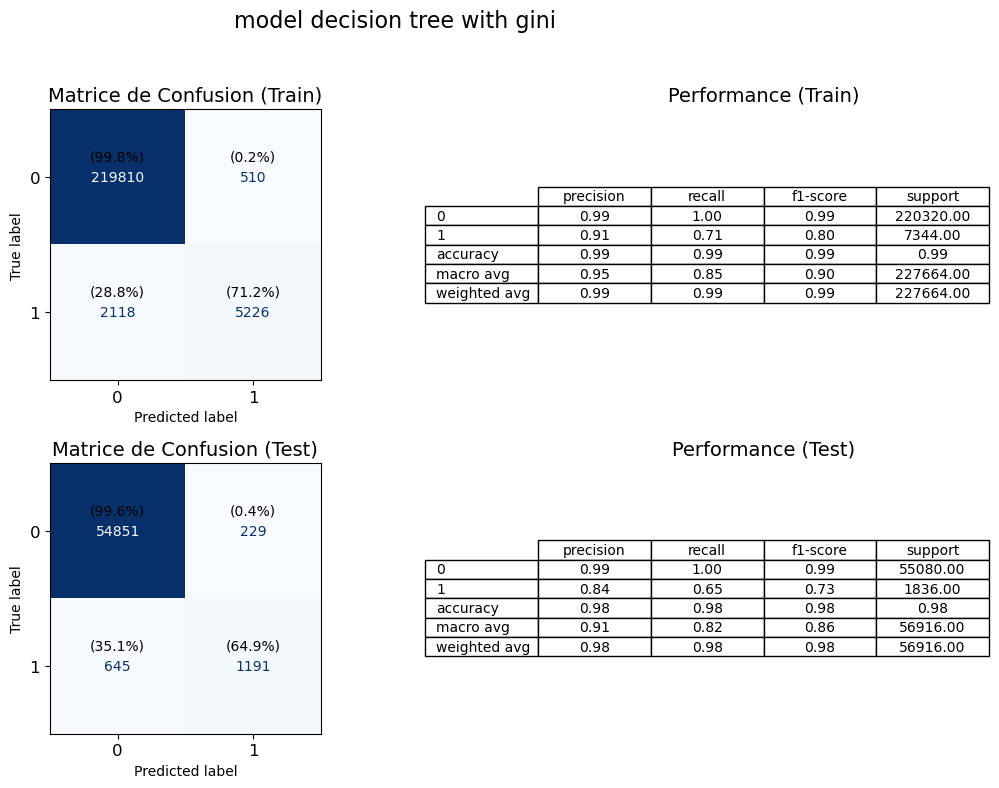

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



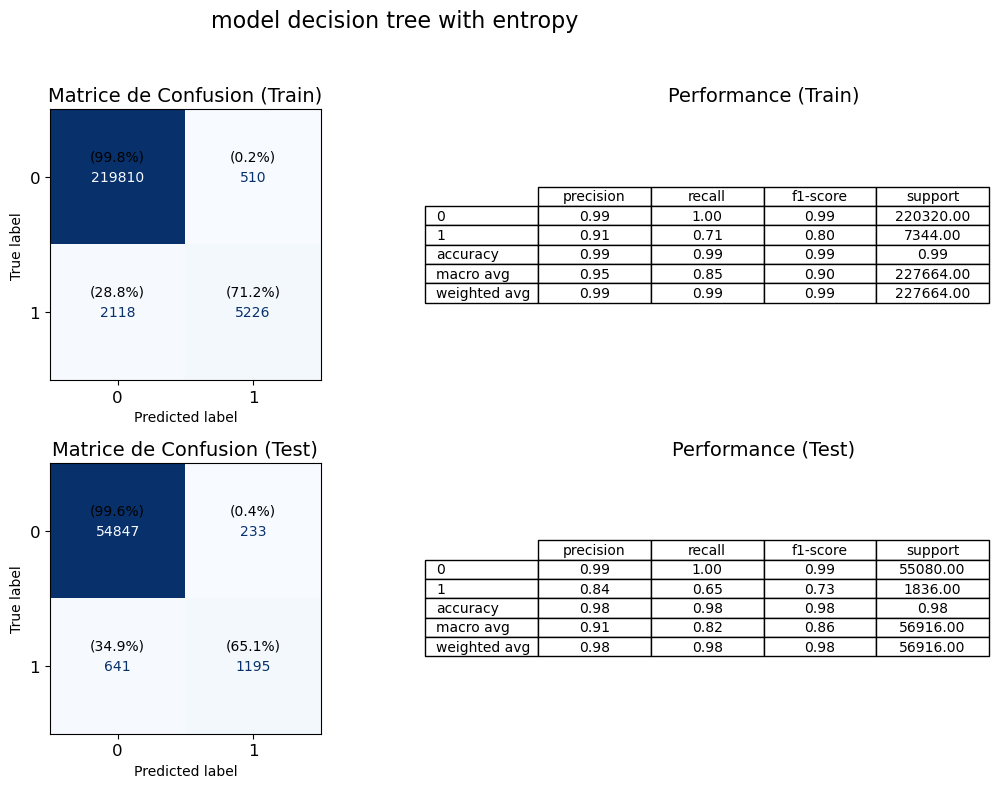

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



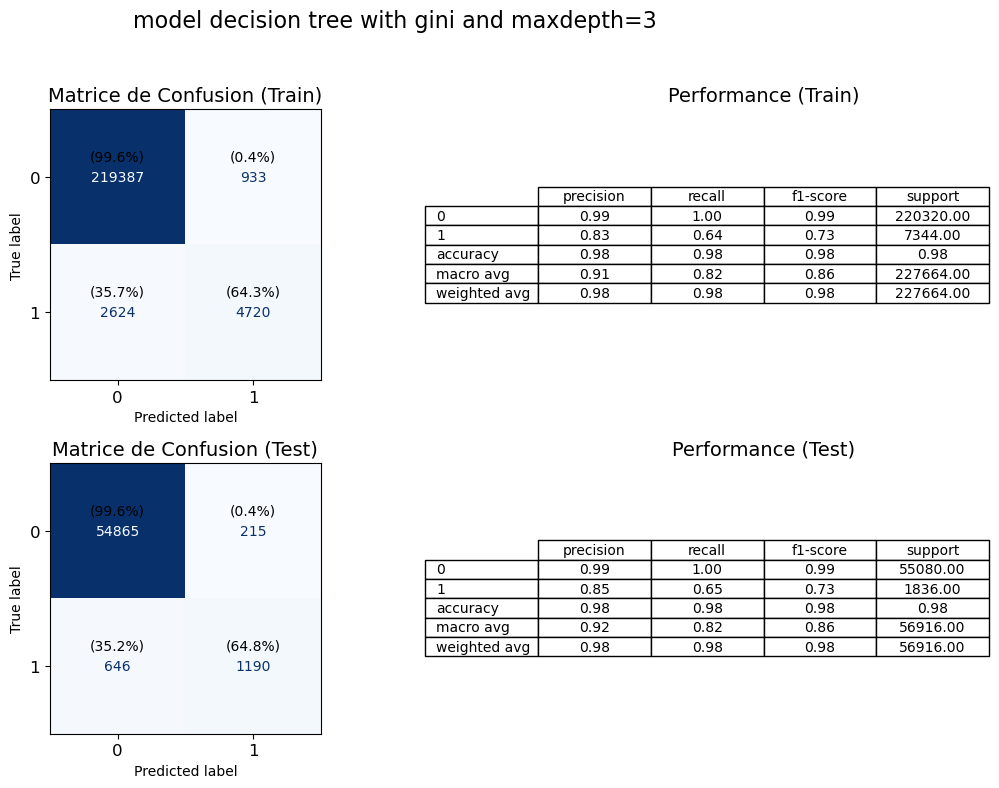

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



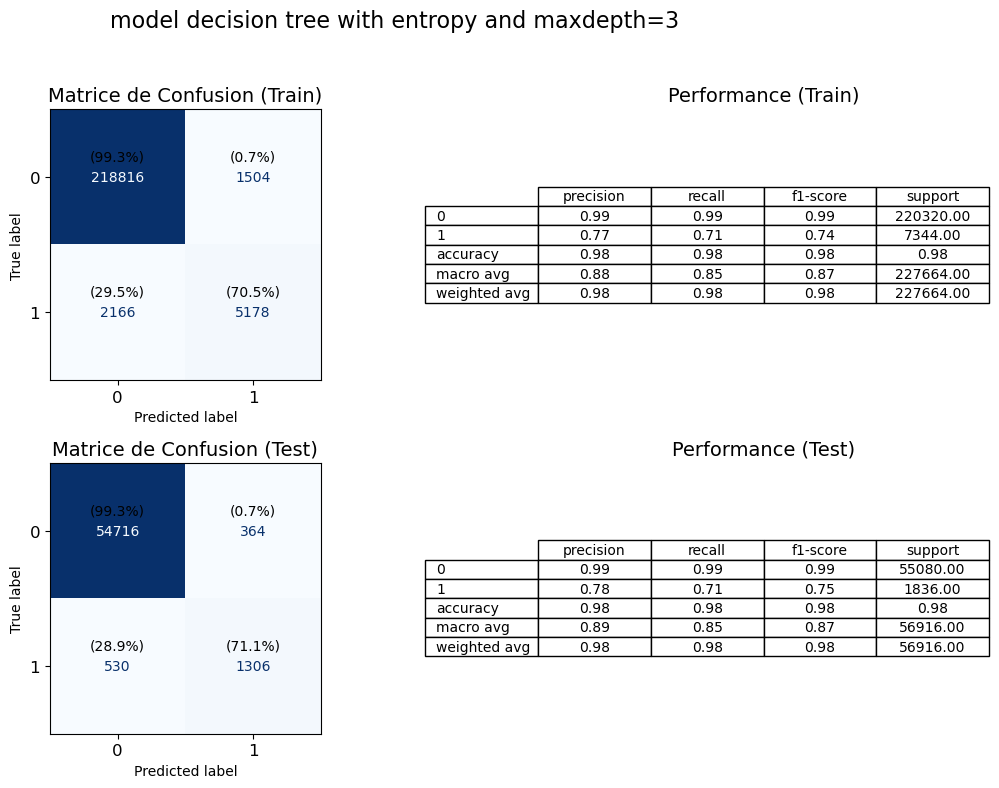

In [69]:
# Exemple d'utilisation de la fonction
graph_perf(dt_gini, x_train, y_train, x_test, y_test, label_encoder, title="model decision tree with gini" )
graph_perf(dt_entropy, x_train, y_train, x_test, y_test, label_encoder,title="model decision tree with entropy" )
graph_perf(dt_mini_gini, x_train, y_train, x_test, y_test, label_encoder,title="model decision tree with gini and maxdepth=3")
graph_perf(dt_mini_entropy, x_train, y_train, x_test, y_test, label_encoder,title="model decision tree with entropy and maxdepth=3")

In [70]:
from sklearn.model_selection import GridSearchCV

classifier = DecisionTreeClassifier()
params = {'max_depth' : np.arange(7,15),
         'min_samples_split' : [15, 20, 30, 40, 50],
         "min_samples_leaf": [1, 2, 5],
         'criterion': ['gini', 'entropy']}

grid =  GridSearchCV(estimator=classifier, param_grid= params, cv = 10,n_jobs=-1)
grid.fit(x_train, y_train)

print("train results \n")
print(classification_report(y_train, grid.best_estimator_.predict(x_train), target_names=label_encoder.classes_))
print("test result  \n")
print(classification_report(y_test, grid.best_estimator_.predict(x_test), target_names=label_encoder.classes_))
print(grid.best_params_)


train results 

              precision    recall  f1-score   support

           0       0.99      1.00      0.99    220320
           1       0.86      0.69      0.76      7344

    accuracy                           0.99    227664
   macro avg       0.92      0.84      0.88    227664
weighted avg       0.99      0.99      0.99    227664

test result  

              precision    recall  f1-score   support

           0       0.99      1.00      0.99     55080
           1       0.85      0.68      0.76      1836

    accuracy                           0.99     56916
   macro avg       0.92      0.84      0.87     56916
weighted avg       0.98      0.99      0.99     56916

{'criterion': 'gini', 'max_depth': 9, 'min_samples_leaf': 2, 'min_samples_split': 30}


C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.

C:\Users\licor\AppData\Local\Temp\ipykernel_11072\3401848150.py:43: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



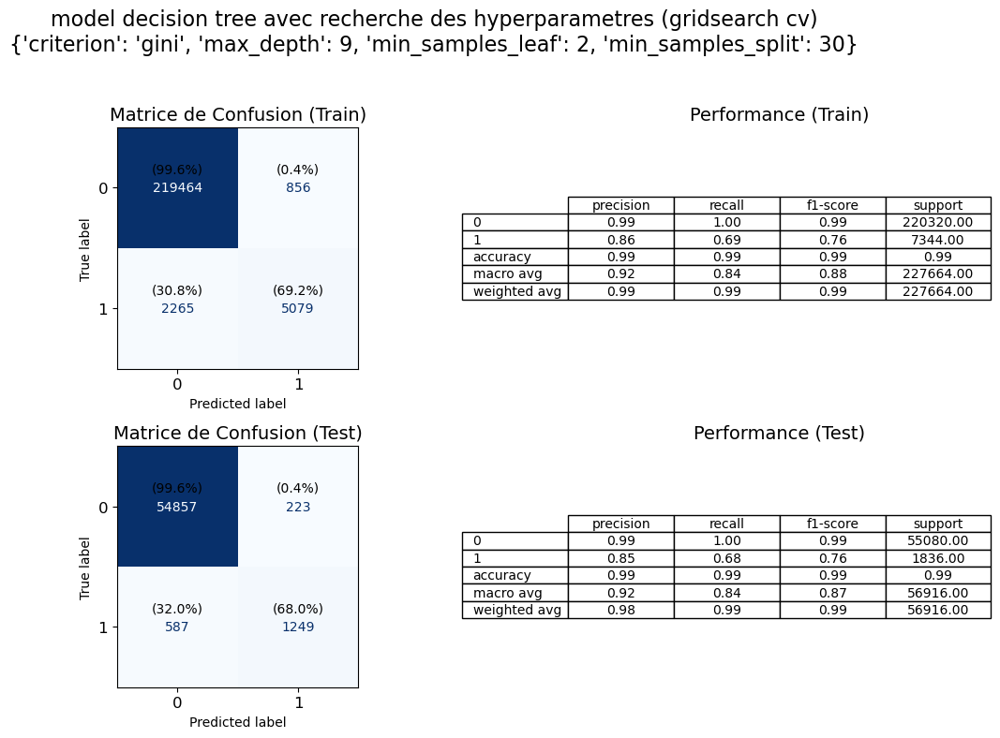

In [71]:
graph_perf(grid, x_train, y_train, x_test, y_test, label_encoder, title=f"model decision tree avec recherche des hyperparametres (gridsearch cv)\n{grid.best_params_}" )

In [72]:
# Read data without labels
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)
data_without_labels


Prediction set (without labels) : (31620, 5)


,country,age,new_user,source,total_pages_visited
0,UK,28,0,Seo,16
1,UK,22,1,Direct,5
2,China,32,1,Seo,1
3,US,32,1,Ads,6
4,China,25,0,Seo,3
...,...,...,...,...,...
31615,Germany,25,1,Seo,3
31616,US,36,1,Ads,7
31617,UK,33,1,Seo,5
31618,UK,25,1,Seo,14


In [73]:
# WARNING : PUT HERE THE SAME PREPROCESSING AS FOR YOUR TEST SET
# CHECK YOU ARE USING X_without_labels
print("Encoding categorical features and standardizing numerical features...")

X_without_labels = preprocessor.transform(data_without_labels)
print("...Done")
print(X_without_labels[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.30954104  3.32689285  0.          1.          0.          0.
   0.          1.        ]
 [-1.03476387  0.03721457  0.          1.          0.          1.
   1.          0.        ]
 [ 0.17394084 -1.15903208  0.          0.          0.          1.
   0.          1.        ]
 [ 0.17394084  0.33627623  0.          0.          1.          1.
   0.          0.        ]
 [-0.67215246 -0.56090876  0.          0.          0.          0.
   0.          1.        ]]


In [74]:
pred_test_file = grid.best_estimator_.predict(X_without_labels)
pred_test_file

array([1, 0, 0, ..., 0, 0, 0])

In [75]:
# Make predictions and dump to file
# WARNING : MAKE SURE THE FILE IS A CSV WITH ONE COLUMN NAMED 'converted' AND NO INDEX !
# WARNING : FILE NAME MUST HAVE FORMAT 'conversion_data_test_predictions_[name].csv'
# where [name] is the name of your team/model separated by a '-'
# For example : [name] = AURELIE-model1
data = {
    'converted': pred_test_file}

suffixe = "jej-baserDT"

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv(f"conversion_data_test_predictions_{suffixe}.csv", index=False)